In [1]:
import xarray
import rioxarray
import numpy as np
from pathlib import Path
import pandas as pd

In [2]:
pekel_dir = Path("../data/pekel/occurrence")
fns = list(pekel_dir.glob("*.tif"))
fns

[PosixPath('../data/pekel/occurrence/occurrence_60W_10Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_110W_20Sv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_50W_50Sv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_110W_80Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_90W_20Sv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_150E_0Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_150W_40Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_120E_40Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_150W_80Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_150E_40Sv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_100W_80Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_120E_70Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_140E_50Nv1_4_2021.tif'),
 PosixPath('../data/pekel/occurrence/occurrence_150E_30

<Axes: >

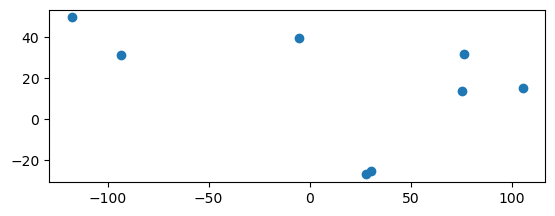

In [3]:
import geopandas as gpd
from pathlib import Path

# read the bounding box of the study area
val_pts = gpd.read_file(Path('../data/validation-locations/subset-validation-reservoirs-grand-pts.geojson'))
val_polys = gpd.read_file(Path('../data/validation-locations/subset-validation-reservoirs-grand.geojson'))

selected_reservoirs = [
    # '0505', # dumboor. India
    '0810', # sirindhorn, Thailand.
    # '0830', # Krasoew, Thailand.
    '0502', # Bhakra dam, India.
    '0518', # Bhadra, India.
    '0349', # vaaldam, South Africa.
    '0464', # Sterkspruit, South Africa.
    '0214', # Cijara, Spain
    '1498', # Toledo bend, US
    '0936', # Arrow, Canada
]

val_res_pt = val_pts.loc[val_pts['tmsos_id'].isin(selected_reservoirs)]
val_res_poly = val_polys.loc[val_polys['tmsos_id'].isin(selected_reservoirs)]

val_res_pt.plot()

In [4]:
buffer_amt = 0.01 * val_res_poly['AREA_SKM_right'] * 1e-2
buffer_amt

7     0.051005
24    0.059962
42    0.003022
47    0.028781
52    0.001202
60    0.009194
75    0.009739
97    0.023558
Name: AREA_SKM_right, dtype: float64

In [5]:
val_res_poly_buffered = val_res_poly.copy()
val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)

res = val_res_poly_buffered.loc[(val_res_poly_buffered['tmsos_id']=='0810').values]
res

/tmp/ipykernel_317318/2941174686.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)


,GRAND_ID_left,RES_NAME_left,DAM_NAME_left,ALT_NAME_left,RIVER_left,ALT_RIVER_left,MAIN_BASIN_left,SUB_BASIN_left,NEAR_CITY_left,ALT_CITY_left,...,db,name,rid_id,grand_id,rid_filepath,resops_id,rid_filename,tmsos_id,distance,geometry
97,5796,Noi,Sirindhorn,None,Lam Dom Noi,None,Mekong,None,None,None,...,rid,Sirindhorn,200212.0,5796.0,mekong_insitu/200212-Sirindhorn_Dam.csv,NaN,200212-Sirindhorn_Dam.csv,0810,NaN,"POLYGON ((105.28711 14.94671, 105.28609 14.948..."


In [6]:
import xarray as xr

w, s, e, n = res.total_bounds

# e += 10
print(w, s, e, n)

we = np.arange(w.round(-1)-10, e.round(-1) if abs(e.round(-1) - w.round(-1)) <= 10 else e.round(-1), 10)
we = [x - 360*int(x/360) if x >= 360 else x for x in we]
sn = np.arange(s.round(-1)+10, n.round(-1) + 10 if abs(n.round(-1)-s.round(-1)) <= 10 else n.round(-1), 10)

we = [f"{int(lon)}W" if lon < 0 else f"{int(lon)}E" for lon in we]
sn = [f"{int(lat)}S" if lat < 0 else f"{int(lat)}N" for lat in sn]

print(we)
print(sn)

# dsses = []
fns = []
for W in we:
    for S in sn:
        fn = pekel_dir / f"occurrence_{W}_{S}v1_4_2021.tif"
        fns.append(fn)
        # ds = xarray.open_dataset(fn, engine='rasterio')
        # dsses.append(ds)
# ds = xr.merge(dsses)
# ds
ds = xr.open_mfdataset(fns, engine='rasterio').sel(band=1)
ds

105.28268863283537 14.775752477413114 105.48898740350354 15.231529449821076
['100E']
['20N']


<xarray.Dataset> Size: 6GB
Dimensions:      (x: 40000, y: 40000)
Coordinates:
    band         int64 8B 1
  * x            (x) float64 320kB 100.0 100.0 100.0 100.0 ... 110.0 110.0 110.0
  * y            (y) float64 320kB 20.0 20.0 20.0 20.0 ... 10.0 10.0 10.0 10.0
    spatial_ref  int64 8B ...
Data variables:
    band_data    (y, x) float32 6GB dask.array<chunksize=(256, 256), meta=np.ndarray>

In [7]:
ds_clipped = ds.rio.clip(res.geometry.values, drop=True)
ds_clipped = ds_clipped.rename({'band_data': 'occurrence'})
# ds_clipped['reservoir'] = res['tmsos_id'].values[0]
ds_clipped = ds_clipped.chunk({
    'x': 1024, 'y': 1024
})
ds_clipped = ds_clipped.assign_coords(
    {'reservoir': [res['tmsos_id'].values[0]]}
)
ds_clipped

<xarray.Dataset> Size: 6MB
Dimensions:      (x: 825, y: 1823, reservoir: 1)
Coordinates:
    band         int64 8B 1
  * x            (x) float64 7kB 105.3 105.3 105.3 105.3 ... 105.5 105.5 105.5
  * y            (y) float64 15kB 15.23 15.23 15.23 15.23 ... 14.78 14.78 14.78
    spatial_ref  int64 8B 0
  * reservoir    (reservoir) <U4 16B '0810'
Data variables:
    occurrence   (y, x) float32 6MB dask.array<chunksize=(1024, 825), meta=np.ndarray>

In [11]:
save_dir = Path('../data/pekel/res_wise')

ds_clipped.to_zarr(save_dir / f"{res['tmsos_id'].values[0]}.zarr", consolidated=True, mode='w', compute=True)

/tmp/ipykernel_310949/173992545.py:3: SerializationWarning: saving variable None with floating point data as an integer dtype without any _FillValue to use for NaNs
  ds_clipped.to_zarr(save_dir / f"{res['tmsos_id'].values[0]}.zarr", consolidated=True, mode='w', compute=True)


/tiger1/pdas47/tmsosPP/.env/lib/python3.12/site-packages/dask/array/chunk.py:278: RuntimeWarning: invalid value encountered in cast
  return x.astype(astype_dtype, **kwargs)


Read locally.

In [13]:
fn = Path(f'../data/pekel/res_wise/{res['tmsos_id'].values[0]}.zarr')
ds_clipped = xr.open_dataset(fn)
ds_clipped

/tiger1/pdas47/tmsosPP/.env/lib/python3.12/site-packages/xarray/backends/plugins.py:159: RuntimeWarning: 'netcdf4' fails while guessing
  warnings.warn(f"{engine!r} fails while guessing", RuntimeWarning)
/tiger1/pdas47/tmsosPP/.env/lib/python3.12/site-packages/xarray/backends/plugins.py:159: RuntimeWarning: 'scipy' fails while guessing
  warnings.warn(f"{engine!r} fails while guessing", RuntimeWarning)


<xarray.Dataset> Size: 12MB
Dimensions:      (y: 1823, x: 825, reservoir: 1)
Coordinates:
    band         int64 8B ...
  * reservoir    (reservoir) <U4 16B '0810'
  * x            (x) float64 7kB 105.3 105.3 105.3 105.3 ... 105.5 105.5 105.5
  * y            (y) float64 15kB 15.23 15.23 15.23 15.23 ... 14.78 14.78 14.78
Data variables:
    occurrence   (y, x) float64 12MB ...
    spatial_ref  int64 8B ...

In [15]:
import hvplot.xarray
ds_clipped['occurrence'].hvplot.contourf(levels=20, geo=True, height=600, width=800)

:Polygons   [x,y]   (occurrence)

# in one function

In [20]:
from tqdm.notebook import tqdm
import xarray as xr

# read the bounding box of the study area
def get_pekel_id(id, pekel_dir=Path('../data/pekel/occurrence'), buffer_multiplier=0.01):
    val_pts = gpd.read_file(Path('../data/validation-locations/subset-validation-reservoirs-grand-pts.geojson'))
    val_polys = gpd.read_file(Path('../data/validation-locations/subset-validation-reservoirs-grand.geojson'))
    val_res_pt = val_pts.loc[val_pts['tmsos_id'] == id]
    val_res_poly = val_polys.loc[val_polys['tmsos_id'] == id]
    buffer_amt = buffer_multiplier * val_res_poly['AREA_SKM_right'] * 1e-2
    val_res_poly_buffered = val_res_poly.copy()
    val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)

    res = val_res_poly_buffered.loc[(val_res_poly_buffered['tmsos_id']==id).values]

    # determine 
    w, s, e, n = res.total_bounds
    
    we = np.arange(w.round(-1)-10, e.round(-1)+10 if abs(e.round(-1) - w.round(-1)) <= 10 else e.round(-1), 10)
    we = [x - 360*int(x/360) if x >= 360 else x for x in we]
    sn = np.arange(s.round(-1), n.round(-1)+20 if abs(n.round(-1)-s.round(-1)) <= 10 else n.round(-1), 10)
    
    we = [f"{abs(int(lon))}W" if lon < 0 else f"{int(lon)}E" for lon in we]
    sn = [f"{abs(int(lat))}S" if lat < 0 else f"{int(lat)}N" for lat in sn]
    # print(s.round(-1), n.round(-1))
    # print(w, w.round(-1), s, e, n)
    print(f"{w:.2f}, {s:.2f}, {e:.2f}, {n:.2f}")
    print(we, sn)
    fns = []
    for W in we:
        for S in sn:
            fn = pekel_dir / f"occurrence_{W}_{S}v1_4_2021.tif"
            fns.append(fn)
    # print(fns)
    ds = xr.open_mfdataset(fns, engine='rasterio').sel(band=1)

    ds_clipped = ds.rio.clip(res.geometry.values, drop=True)
    ds_clipped = ds_clipped.rename({'band_data': 'occurrence'})
    # ds_clipped['reservoir'] = res['tmsos_id'].values[0]
    ds_clipped = ds_clipped.chunk({
        'x': 1024, 'y': 1024
    })
    ds_clipped = ds_clipped.assign_coords(
        {'reservoir': [res['tmsos_id'].values[0]]}
    )
    
    return ds_clipped


save_dir = Path('../data/pekel/res_wise/')

for reservoir_id in tqdm(selected_reservoirs[4:]):
    ds = get_pekel_id(reservoir_id)
    save_fp = save_dir / f"{reservoir_id}.zarr"
    # ds.to_zarr(save_fp, mode='w', consolidated=True)

  0%|          | 0/4 [00:00<?, ?it/s]

/tmp/ipykernel_314255/2352166071.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)


30.34, -25.39, 30.39, -25.32
['20E', '30E'] ['30S', '20S']


/tmp/ipykernel_314255/2352166071.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)


-5.03, 39.23, -4.75, 39.43
['20W', '10W', '0E'] ['40N', '50N']


/tmp/ipykernel_314255/2352166071.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)


-94.00, 31.08, -93.51, 31.97
['100W', '90W'] ['30N', '40N']


/tmp/ipykernel_314255/2352166071.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)


-118.26, 49.28, -117.66, 51.03
['130W', '120W'] ['50N', '60N']


In [20]:
import xarray as xr
import hvplot.xarray
import geoviews as gv

print(selected_reservoirs)

val_res_poly_buffered = val_res_poly.copy()
val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)

res = val_res_poly_buffered[val_res_poly_buffered['tmsos_id'] == selected_reservoirs[2]]

fn = Path(f'../data/pekel/res_wise/{res['tmsos_id'].values[0]}.zarr')
ds_clipped = xr.open_dataset(fn, engine='zarr')
ds_clipped = ds_clipped.where(ds_clipped['occurrence'] > 0)
# ds_clipped
ds_clipped['occurrence'].hvplot('x', 'y', geo=True, height=600, width=800, tiles='OSM')

['0810', '0502', '0518', '0349', '0464', '0214', '1498', '0936']


/tmp/ipykernel_317318/1740826892.py:8: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  val_res_poly_buffered['geometry'] = val_res_poly['geometry'].buffer(buffer_amt)


:Overlay
   .WMTS.I  :WMTS   [Longitude,Latitude]
   .Image.I :Image   [x,y]   (occurrence)